<a href="https://colab.research.google.com/github/myarist/ArsipDigital/blob/main/Project/E%20Commerce%20-%20Analytics.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Proyek Analisis Data: E Commerce
- **Nama:** Muhammad Yusuf Aristyanto
- **Email:** aristyanto2320@gmail.com
- **ID Dicoding:** myarist



---



## Menentukan Pertanyaan Bisnis

1. Produk apa yang paling banyak dibeli oleh pelanggan?
3. Berapa banyak pelanggan yang melakukan pembelian berulang?
4. Berapa rata-rata nilai transaksi per pelanggan?
5. Kategori produk apa yang paling menghasilkan pendapatan?
6. Metode pembayaran apa yang paling sering digunakan oleh pelanggan?
7. Bagaimana tingkat kepuasan pelanggan terhadap layanan dan produk yang ditawarkan?




---



## Import Semua Packages/Library yang Digunakan

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

import os
os.chdir('/content/drive/MyDrive/BPS/Coding/Dicoding/Belajar_Analisis_Data_dengan_Python/Project')

Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).


In [ ]:
import numpy as np                # Untuk operasi numerik dan array
import pandas as pd               # Untuk manipulasi dan analisis data
import matplotlib.pyplot as plt   # Untuk visualisasi data statis
import seaborn as sns             # Untuk visualisasi data yang lebih menarik dan informatif
import datetime                   # Untuk manipulasi dan analisis data tanggal
import folium
from folium.plugins import MarkerCluster


---



## Data Wrangling

### Gathering Data

In [ ]:
customers_data = pd.read_csv('Data/e_commerce/olist_customers_dataset.csv', dtype={'customer_zip_code_prefix': str})
customers_data

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,09790,sao bernardo do campo,SP
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,01151,sao paulo,SP
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,08775,mogi das cruzes,SP
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP
...,...,...,...,...,...
99436,17ddf5dd5d51696bb3d7c6291687be6f,1a29b476fee25c95fbafc67c5ac95cf8,03937,sao paulo,SP
99437,e7b71a9017aa05c9a7fd292d714858e8,d52a67c98be1cf6a5c84435bd38d095d,06764,taboao da serra,SP
99438,5e28dfe12db7fb50a4b2f691faecea5e,e9f50caf99f032f0bf3c55141f019d99,60115,fortaleza,CE
99439,56b18e2166679b8a959d72dd06da27f9,73c2643a0a458b49f58cea58833b192e,92120,canoas,RS


In [ ]:
geolocation_data = pd.read_csv('Data/e_commerce/olist_geolocation_dataset.csv', dtype={'geolocation_zip_code_prefix': str})
geolocation_data

,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state
0,01037,-23.545621,-46.639292,sao paulo,SP
1,01046,-23.546081,-46.644820,sao paulo,SP
2,01046,-23.546129,-46.642951,sao paulo,SP
3,01041,-23.544392,-46.639499,sao paulo,SP
4,01035,-23.541578,-46.641607,sao paulo,SP
...,...,...,...,...,...
1000158,99950,-28.068639,-52.010705,tapejara,RS
1000159,99900,-27.877125,-52.224882,getulio vargas,RS
1000160,99950,-28.071855,-52.014716,tapejara,RS
1000161,99980,-28.388932,-51.846871,david canabarro,RS


In [ ]:
order_items_data = pd.read_csv('Data/e_commerce/olist_order_items_dataset.csv')
order_items_data

,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value
0,00010242fe8c5a6d1ba2dd792cb16214,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,2017-09-19 09:45:35,58.90,13.29
1,00018f77f2f0320c557190d7a144bdd3,1,e5f2d52b802189ee658865ca93d83a8f,dd7ddc04e1b6c2c614352b383efe2d36,2017-05-03 11:05:13,239.90,19.93
2,000229ec398224ef6ca0657da4fc703e,1,c777355d18b72b67abbeef9df44fd0fd,5b51032eddd242adc84c38acab88f23d,2018-01-18 14:48:30,199.00,17.87
3,00024acbcdf0a6daa1e931b038114c75,1,7634da152a4610f1595efa32f14722fc,9d7a1d34a5052409006425275ba1c2b4,2018-08-15 10:10:18,12.99,12.79
4,00042b26cf59d7ce69dfabb4e55b4fd9,1,ac6c3623068f30de03045865e4e10089,df560393f3a51e74553ab94004ba5c87,2017-02-13 13:57:51,199.90,18.14
...,...,...,...,...,...,...,...
112645,fffc94f6ce00a00581880bf54a75a037,1,4aa6014eceb682077f9dc4bffebc05b0,b8bc237ba3788b23da09c0f1f3a3288c,2018-05-02 04:11:01,299.99,43.41
112646,fffcd46ef2263f404302a634eb57f7eb,1,32e07fd915822b0765e448c4dd74c828,f3c38ab652836d21de61fb8314b69182,2018-07-20 04:31:48,350.00,36.53
112647,fffce4705a9662cd70adb13d4a31832d,1,72a30483855e2eafc67aee5dc2560482,c3cfdc648177fdbbbb35635a37472c53,2017-10-30 17:14:25,99.90,16.95
112648,fffe18544ffabc95dfada21779c9644f,1,9c422a519119dcad7575db5af1ba540e,2b3e4a2a3ea8e01938cabda2a3e5cc79,2017-08-21 00:04:32,55.99,8.72


In [ ]:
order_payments_data = pd.read_csv('Data/e_commerce/olist_order_payments_dataset.csv')
order_payments_data

,order_id,payment_sequential,payment_type,payment_installments,payment_value
0,b81ef226f3fe1789b1e8b2acac839d17,1,credit_card,8,99.33
1,a9810da82917af2d9aefd1278f1dcfa0,1,credit_card,1,24.39
2,25e8ea4e93396b6fa0d3dd708e76c1bd,1,credit_card,1,65.71
3,ba78997921bbcdc1373bb41e913ab953,1,credit_card,8,107.78
4,42fdf880ba16b47b59251dd489d4441a,1,credit_card,2,128.45
...,...,...,...,...,...
103881,0406037ad97740d563a178ecc7a2075c,1,boleto,1,363.31
103882,7b905861d7c825891d6347454ea7863f,1,credit_card,2,96.80
103883,32609bbb3dd69b3c066a6860554a77bf,1,credit_card,1,47.77
103884,b8b61059626efa996a60be9bb9320e10,1,credit_card,5,369.54


In [ ]:
order_reviews_data = pd.read_csv('Data/e_commerce/olist_order_reviews_dataset.csv')
order_reviews_data

,review_id,order_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp
0,7bc2406110b926393aa56f80a40eba40,73fc7af87114b39712e6da79b0a377eb,4,NaN,NaN,2018-01-18 00:00:00,2018-01-18 21:46:59
1,80e641a11e56f04c1ad469d5645fdfde,a548910a1c6147796b98fdf73dbeba33,5,NaN,NaN,2018-03-10 00:00:00,2018-03-11 03:05:13
2,228ce5500dc1d8e020d8d1322874b6f0,f9e4b658b201a9f2ecdecbb34bed034b,5,NaN,NaN,2018-02-17 00:00:00,2018-02-18 14:36:24
3,e64fb393e7b32834bb789ff8bb30750e,658677c97b385a9be170737859d3511b,5,NaN,Recebi bem antes do prazo estipulado.,2017-04-21 00:00:00,2017-04-21 22:02:06
4,f7c4243c7fe1938f181bec41a392bdeb,8e6bfb81e283fa7e4f11123a3fb894f1,5,NaN,Parabéns lojas lannister adorei comprar pela I...,2018-03-01 00:00:00,2018-03-02 10:26:53
...,...,...,...,...,...,...,...
99219,574ed12dd733e5fa530cfd4bbf39d7c9,2a8c23fee101d4d5662fa670396eb8da,5,NaN,NaN,2018-07-07 00:00:00,2018-07-14 17:18:30
99220,f3897127253a9592a73be9bdfdf4ed7a,22ec9f0669f784db00fa86d035cf8602,5,NaN,NaN,2017-12-09 00:00:00,2017-12-11 20:06:42
99221,b3de70c89b1510c4cd3d0649fd302472,55d4004744368f5571d1f590031933e4,5,NaN,"Excelente mochila, entrega super rápida. Super...",2018-03-22 00:00:00,2018-03-23 09:10:43
99222,1adeb9d84d72fe4e337617733eb85149,7725825d039fc1f0ceb7635e3f7d9206,4,NaN,NaN,2018-07-01 00:00:00,2018-07-02 12:59:13


In [ ]:
orders_data = pd.read_csv('Data/e_commerce/olist_orders_dataset.csv')
orders_data

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13 00:00:00
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04 00:00:00
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15 00:00:00
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26 00:00:00
...,...,...,...,...,...,...,...,...
99436,9c5dedf39a927c1b2549525ed64a053c,39bd1228ee8140590ac3aca26f2dfe00,delivered,2017-03-09 09:54:05,2017-03-09 09:54:05,2017-03-10 11:18:03,2017-03-17 15:08:01,2017-03-28 00:00:00
99437,63943bddc261676b46f01ca7ac2f7bd8,1fca14ff2861355f6e5f14306ff977a7,delivered,2018-02-06 12:58:58,2018-02-06 13:10:37,2018-02-07 23:22:42,2018-02-28 17:37:56,2018-03-02 00:00:00
99438,83c1379a015df1e13d02aae0204711ab,1aa71eb042121263aafbe80c1b562c9c,delivered,2017-08-27 14:46:43,2017-08-27 15:04:16,2017-08-28 20:52:26,2017-09-21 11:24:17,2017-09-27 00:00:00
99439,11c177c8e97725db2631073c19f07b62,b331b74b18dc79bcdf6532d51e1637c1,delivered,2018-01-08 21:28:27,2018-01-08 21:36:21,2018-01-12 15:35:03,2018-01-25 23:32:54,2018-02-15 00:00:00


In [ ]:
products_data = pd.read_csv('Data/e_commerce/olist_products_dataset.csv')
products_data

,product_id,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
0,1e9e8ef04dbcff4541ed26657ea517e5,perfumaria,40.0,287.0,1.0,225.0,16.0,10.0,14.0
1,3aa071139cb16b67ca9e5dea641aaa2f,artes,44.0,276.0,1.0,1000.0,30.0,18.0,20.0
2,96bd76ec8810374ed1b65e291975717f,esporte_lazer,46.0,250.0,1.0,154.0,18.0,9.0,15.0
3,cef67bcfe19066a932b7673e239eb23d,bebes,27.0,261.0,1.0,371.0,26.0,4.0,26.0
4,9dc1a7de274444849c219cff195d0b71,utilidades_domesticas,37.0,402.0,4.0,625.0,20.0,17.0,13.0
...,...,...,...,...,...,...,...,...,...
32946,a0b7d5a992ccda646f2d34e418fff5a0,moveis_decoracao,45.0,67.0,2.0,12300.0,40.0,40.0,40.0
32947,bf4538d88321d0fd4412a93c974510e6,construcao_ferramentas_iluminacao,41.0,971.0,1.0,1700.0,16.0,19.0,16.0
32948,9a7c6041fa9592d9d9ef6cfe62a71f8c,cama_mesa_banho,50.0,799.0,1.0,1400.0,27.0,7.0,27.0
32949,83808703fc0706a22e264b9d75f04a2e,informatica_acessorios,60.0,156.0,2.0,700.0,31.0,13.0,20.0


In [ ]:
sellers_data = pd.read_csv('Data/e_commerce/olist_sellers_dataset.csv', dtype={'seller_zip_code_prefix': str})
sellers_data

,seller_id,seller_zip_code_prefix,seller_city,seller_state
0,3442f8959a84dea7ee197c632cb2df15,13023,campinas,SP
1,d1b65fc7debc3361ea86b5f14c68d2e2,13844,mogi guacu,SP
2,ce3ad9de960102d0677a81f5d0bb7b2d,20031,rio de janeiro,RJ
3,c0f3eea2e14555b6faeea3dd58c1b1c3,04195,sao paulo,SP
4,51a04a8a6bdcb23deccc82b0b80742cf,12914,braganca paulista,SP
...,...,...,...,...
3090,98dddbc4601dd4443ca174359b237166,87111,sarandi,PR
3091,f8201cab383e484733266d1906e2fdfa,88137,palhoca,SC
3092,74871d19219c7d518d0090283e03c137,04650,sao paulo,SP
3093,e603cf3fec55f8697c9059638d6c8eb5,96080,pelotas,RS


In [ ]:
category_data = pd.read_csv('Data/e_commerce/product_category_name_translation.csv')
category_data

,product_category_name,product_category_name_english
0,beleza_saude,health_beauty
1,informatica_acessorios,computers_accessories
2,automotivo,auto
3,cama_mesa_banho,bed_bath_table
4,moveis_decoracao,furniture_decor
...,...,...
66,flores,flowers
67,artes_e_artesanato,arts_and_craftmanship
68,fraldas_higiene,diapers_and_hygiene
69,fashion_roupa_infanto_juvenil,fashion_childrens_clothes


In [ ]:
# Gabungkan data menggunakan pd.merge secara bertahap untuk mengurangi beban memori
merged_data = pd.merge(orders_data, customers_data, on='customer_id', how='left')
merged_data = pd.merge(merged_data, order_items_data, on='order_id', how='left')
merged_data = pd.merge(merged_data, order_payments_data, on='order_id', how='left')
merged_data = pd.merge(merged_data, order_reviews_data, on='order_id', how='left')
merged_data = pd.merge(merged_data, products_data, on='product_id', how='left')
merged_data = pd.merge(merged_data, sellers_data, on='seller_id', how='left')
merged_data = pd.merge(merged_data, category_data, on='product_category_name', how='left')

merged_data

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,customer_unique_id,customer_zip_code_prefix,...,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,seller_zip_code_prefix,seller_city,seller_state,product_category_name_english
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00,7c396fd4830fd04220f754e42b4e5bff,03149,...,268.0,4.0,500.0,19.0,8.0,13.0,09350,maua,SP,housewares
1,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00,7c396fd4830fd04220f754e42b4e5bff,03149,...,268.0,4.0,500.0,19.0,8.0,13.0,09350,maua,SP,housewares
2,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00,7c396fd4830fd04220f754e42b4e5bff,03149,...,268.0,4.0,500.0,19.0,8.0,13.0,09350,maua,SP,housewares
3,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13 00:00:00,af07308b275d755c9edb36a90c618231,47813,...,178.0,1.0,400.0,19.0,13.0,19.0,31570,belo horizonte,SP,perfumery
4,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04 00:00:00,3a653a41f6f9fc3d2a113cf8398680e8,75265,...,232.0,1.0,420.0,24.0,19.0,21.0,14840,guariba,SP,auto
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
119138,63943bddc261676b46f01ca7ac2f7bd8,1fca14ff2861355f6e5f14306ff977a7,delivered,2018-02-06 12:58:58,2018-02-06 13:10:37,2018-02-07 23:22:42,2018-02-28 17:37:56,2018-03-02 00:00:00,da62f9e57a76d978d02ab5362c509660,11722,...,828.0,4.0,4950.0,40.0,10.0,40.0,17602,tupa,SP,baby
119139,83c1379a015df1e13d02aae0204711ab,1aa71eb042121263aafbe80c1b562c9c,delivered,2017-08-27 14:46:43,2017-08-27 15:04:16,2017-08-28 20:52:26,2017-09-21 11:24:17,2017-09-27 00:00:00,737520a9aad80b3fbbdad19b66b37b30,45920,...,500.0,2.0,13300.0,32.0,90.0,22.0,08290,sao paulo,SP,home_appliances_2
119140,11c177c8e97725db2631073c19f07b62,b331b74b18dc79bcdf6532d51e1637c1,delivered,2018-01-08 21:28:27,2018-01-08 21:36:21,2018-01-12 15:35:03,2018-01-25 23:32:54,2018-02-15 00:00:00,5097a5312c8b157bb7be58ae360ef43c,28685,...,1893.0,1.0,6550.0,20.0,20.0,20.0,37175,ilicinea,MG,computers_accessories
119141,11c177c8e97725db2631073c19f07b62,b331b74b18dc79bcdf6532d51e1637c1,delivered,2018-01-08 21:28:27,2018-01-08 21:36:21,2018-01-12 15:35:03,2018-01-25 23:32:54,2018-02-15 00:00:00,5097a5312c8b157bb7be58ae360ef43c,28685,...,1893.0,1.0,6550.0,20.0,20.0,20.0,37175,ilicinea,MG,computers_accessories


In [ ]:
merged_data.to_csv('Data/e_commerce/merged_data.csv', index=False)

Menampilkan informasi dasar tentang data per jam

In [ ]:
print(merged_data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 119143 entries, 0 to 119142
Data columns (total 40 columns):
 #   Column                         Non-Null Count   Dtype  
---  ------                         --------------   -----  
 0   order_id                       119143 non-null  object 
 1   customer_id                    119143 non-null  object 
 2   order_status                   119143 non-null  object 
 3   order_purchase_timestamp       119143 non-null  object 
 4   order_approved_at              118966 non-null  object 
 5   order_delivered_carrier_date   117057 non-null  object 
 6   order_delivered_customer_date  115722 non-null  object 
 7   order_estimated_delivery_date  119143 non-null  object 
 8   customer_unique_id             119143 non-null  object 
 9   customer_zip_code_prefix       119143 non-null  object 
 10  customer_city                  119143 non-null  object 
 11  customer_state                 119143 non-null  object 
 12  order_item_id                 

Insight dari hasil merged_data.info()

* Jumlah Baris dan Kolom:
   - Data gabungan memiliki sejumlah besar baris (112650) dan kolom (35).
   - Ini menunjukkan bahwa data yang dikumpulkan sangat besar dan banyak informasi yang terkandung.


* Tipe Data Kolom:
   - Berbagai tipe data digunakan, seperti int64 (numerik bulat), float64 (numerik desimal), object (teks atau campuran), dan datetime64[ns] (tanggal dan waktu).
   - Ini mengindikasikan bahwa data mencakup informasi yang bervariasi, termasuk angka, kategori, dan informasi terkait waktu.


* Kolom dengan Nilai Hilang:
   - Beberapa kolom memiliki nilai yang hilang, yaitu:
       - 'order_approved_at'
       - 'order_delivered_carrier_date'
       - 'order_delivered_customer_date'
       - 'order_estimated_delivery_date'
       - 'product_category_name'
       - 'product_name_lenght'
       - 'product_description_lenght'
       - 'product_photos_qty'
       - 'product_weight_g'
       - 'product_length_cm'
       - 'product_height_cm'
       - 'product_width_cm'
       - 'seller_zip_code_prefix'
       - 'product_category_name_english'
   - Adanya nilai yang hilang menunjukkan bahwa mungkin ada beberapa pesanan yang tidak memiliki informasi lengkap, misal informasi produk atau informasi pengiriman.
   - Hal ini perlu ditangani lebih lanjut (misal diimputasi atau dihapus) agar tidak mengganggu analisis.


* Penggunaan Memori:
   - Data gabungan menggunakan sekitar 29.7 MB memori.
   - Hal ini penting untuk dipertimbangkan karena dapat mempengaruhi performa analisis data, terutama jika bekerja dengan data yang sangat besar.

* Kesimpulan Awal:
   - Data gabungan menyediakan banyak informasi terkait pesanan e-commerce, seperti informasi pelanggan, produk, penjualan, pembayaran, dan review.
   - Adanya nilai yang hilang memerlukan penanganan lebih lanjut untuk meningkatkan kualitas data.
   - Memahami tipe data dan ukuran data membantu merencanakan langkah selanjutnya dalam analisis data, seperti pemilihan metode analisis yang sesuai dan optimasi kinerja.

Dengan informasi ini, kita bisa merencanakan langkah selanjutnya dalam analisis data.
Misalnya, kita bisa mengisi data yang hilang, mengubah tipe data jika perlu, atau melakukan analisis deskriptif untuk melihat pola data yang ada.

Tindak Lanjut

a. Strategi penanganan missing values
* order_approved_at, order_delivered_carrier_date, order_delivered_customer_date:
 - Jika tanggal-tanggal ini penting untuk analisis, kita dapat mengganti nilai yang hilang dengan tanggal rata-rata atau tanggal mode.
 - Jika tidak penting, kita dapat menghapus baris dengan missing values pada kolom-kolom ini.

* product_category_name, product_name_lenght, product_description_lenght, product_photos_qty, product_weight_g,
   product_length_cm, product_height_cm, product_width_cm:
 - Jika kolom-kolom ini penting, kita dapat mengganti missing values dengan mean/median/mode (untuk data numerik)
 - Jika kolom-kolom ini tidak penting, kita dapat menghapus baris dengan missing values pada kolom-kolom ini.

* seller_zip_code_prefix, product_category_name_english:
 - Kita dapat mengganti nilai yang hilang dengan "Unknown" atau "Not Available".


In [ ]:
# Cek missing values
missing_values = merged_data.isnull().sum()
print(missing_values)

order_id                              0
customer_id                           0
order_status                          0
order_purchase_timestamp              0
order_approved_at                   177
order_delivered_carrier_date       2086
order_delivered_customer_date      3421
order_estimated_delivery_date         0
customer_unique_id                    0
customer_zip_code_prefix              0
customer_city                         0
customer_state                        0
order_item_id                       833
product_id                          833
seller_id                           833
shipping_limit_date                 833
price                               833
freight_value                       833
payment_sequential                    3
payment_type                          3
payment_installments                  3
payment_value                         3
review_id                           997
review_score                        997
review_comment_title             105154


In [ ]:
# Hapus data pada beberapa kolom yang memiliki missing value
merged_data.dropna(subset=['order_approved_at', 'order_delivered_carrier_date', 'order_delivered_customer_date',
                          'order_estimated_delivery_date'], inplace=True)

# Isi data pada beberapa kolom yang memiliki missing value
merged_data['product_category_name'].fillna('Unknown', inplace=True)
merged_data['product_category_name_english'].fillna('Unknown', inplace=True)
merged_data['payment_sequential'].fillna(1, inplace=True)
merged_data['payment_type'].fillna('not_defined', inplace=True)
merged_data['payment_installments'].fillna(0, inplace=True)
merged_data['payment_value'].fillna(0, inplace=True)
merged_data['review_comment_title'].fillna('', inplace=True)
merged_data['review_comment_message'].fillna('', inplace=True)
merged_data['review_id'].fillna('No Review', inplace=True)
merged_data['review_score'].fillna(0, inplace=True)
merged_data['seller_zip_code_prefix'].fillna('Unknown', inplace=True)

# Isi data dengan mean pada beberapa kolom yang memiliki missing value
for column in ['product_name_lenght', 'product_description_lenght', 'product_photos_qty', 'product_weight_g',
               'product_length_cm', 'product_height_cm', 'product_width_cm']:
    merged_data[column].fillna(merged_data[column].mean(), inplace=True)

# Isi data dengan ffill() pada beberapa kolom yang memiliki missing value
merged_data['review_creation_date'].ffill(inplace=True)
merged_data['review_answer_timestamp'].ffill(inplace=True)

# Cek kembali missing value
missing_values_after_handling = merged_data.isnull().sum()
print(missing_values_after_handling)

order_id                         0
customer_id                      0
order_status                     0
order_purchase_timestamp         0
order_approved_at                0
order_delivered_carrier_date     0
order_delivered_customer_date    0
order_estimated_delivery_date    0
customer_unique_id               0
customer_zip_code_prefix         0
customer_city                    0
customer_state                   0
order_item_id                    0
product_id                       0
seller_id                        0
shipping_limit_date              0
price                            0
freight_value                    0
payment_sequential               0
payment_type                     0
payment_installments             0
payment_value                    0
review_id                        0
review_score                     0
review_comment_title             0
review_comment_message           0
review_creation_date             0
review_answer_timestamp          0
product_category_nam

b. Membersihkan Data:
   - Periksa dan hapus data duplikat jika ada.
   - Validasi konsistensi data (misal, memastikan rentang nilai yang masuk akal).
   - Contoh: Pastikan tidak ada harga produk negatif, atau pastikan format tanggal valid.

In [ ]:
# Periksa data duplikat
duplicate_rows = merged_data[merged_data.duplicated()]
print("Jumlah baris duplikat:", len(duplicate_rows))

Jumlah baris duplikat: 0


c. Transformasi Data:
   - Jika perlu, mengubah format data (misal, mengubah tipe data).
   - Misalnya, ubah 'order_purchase_timestamp' menjadi tipe data datetime.
   - Membuat kolom baru yang relevan (misal, menghitung selisih waktu antara order purchase dan delivery).

In [ ]:
# Ubah kolom order_purchase_timestamp, order_approved_at, order_delivered_carrier_date,
# order_delivered_customer_date, order_estimated_delivery_date menjadi tipe data datetime
for column in ['order_purchase_timestamp', 'order_approved_at', 'order_delivered_carrier_date',
               'order_delivered_customer_date', 'order_estimated_delivery_date', 'shipping_limit_date',
               'review_creation_date', 'review_answer_timestamp']:
    merged_data[column] = pd.to_datetime(merged_data[column])

# Menghitung selisih waktu antara order purchase dan delivery
merged_data['delivery_time'] = (merged_data['order_delivered_customer_date'] - merged_data['order_purchase_timestamp']).dt.days

# Tambahkan kolom 'order_year' dan 'order_month'
merged_data['order_year'] = merged_data['order_purchase_timestamp'].dt.year
merged_data['order_month'] = merged_data['order_purchase_timestamp'].dt.month

# Menampilkan beberapa baris pertama dari data yang telah ditransformasi
merged_data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 115706 entries, 0 to 119142
Data columns (total 43 columns):
 #   Column                         Non-Null Count   Dtype         
---  ------                         --------------   -----         
 0   order_id                       115706 non-null  object        
 1   customer_id                    115706 non-null  object        
 2   order_status                   115706 non-null  object        
 3   order_purchase_timestamp       115706 non-null  datetime64[ns]
 4   order_approved_at              115706 non-null  datetime64[ns]
 5   order_delivered_carrier_date   115706 non-null  datetime64[ns]
 6   order_delivered_customer_date  115706 non-null  datetime64[ns]
 7   order_estimated_delivery_date  115706 non-null  datetime64[ns]
 8   customer_unique_id             115706 non-null  object        
 9   customer_zip_code_prefix       115706 non-null  object        
 10  customer_city                  115706 non-null  object        
 11  custo

In [ ]:
merged_data

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,customer_unique_id,customer_zip_code_prefix,...,product_length_cm,product_height_cm,product_width_cm,seller_zip_code_prefix,seller_city,seller_state,product_category_name_english,delivery_time,order_year,order_month
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18,7c396fd4830fd04220f754e42b4e5bff,03149,...,19.0,8.0,13.0,09350,maua,SP,housewares,8,2017,10
1,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18,7c396fd4830fd04220f754e42b4e5bff,03149,...,19.0,8.0,13.0,09350,maua,SP,housewares,8,2017,10
2,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18,7c396fd4830fd04220f754e42b4e5bff,03149,...,19.0,8.0,13.0,09350,maua,SP,housewares,8,2017,10
3,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13,af07308b275d755c9edb36a90c618231,47813,...,19.0,13.0,19.0,31570,belo horizonte,SP,perfumery,13,2018,7
4,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04,3a653a41f6f9fc3d2a113cf8398680e8,75265,...,24.0,19.0,21.0,14840,guariba,SP,auto,9,2018,8
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
119138,63943bddc261676b46f01ca7ac2f7bd8,1fca14ff2861355f6e5f14306ff977a7,delivered,2018-02-06 12:58:58,2018-02-06 13:10:37,2018-02-07 23:22:42,2018-02-28 17:37:56,2018-03-02,da62f9e57a76d978d02ab5362c509660,11722,...,40.0,10.0,40.0,17602,tupa,SP,baby,22,2018,2
119139,83c1379a015df1e13d02aae0204711ab,1aa71eb042121263aafbe80c1b562c9c,delivered,2017-08-27 14:46:43,2017-08-27 15:04:16,2017-08-28 20:52:26,2017-09-21 11:24:17,2017-09-27,737520a9aad80b3fbbdad19b66b37b30,45920,...,32.0,90.0,22.0,08290,sao paulo,SP,home_appliances_2,24,2017,8
119140,11c177c8e97725db2631073c19f07b62,b331b74b18dc79bcdf6532d51e1637c1,delivered,2018-01-08 21:28:27,2018-01-08 21:36:21,2018-01-12 15:35:03,2018-01-25 23:32:54,2018-02-15,5097a5312c8b157bb7be58ae360ef43c,28685,...,20.0,20.0,20.0,37175,ilicinea,MG,computers_accessories,17,2018,1
119141,11c177c8e97725db2631073c19f07b62,b331b74b18dc79bcdf6532d51e1637c1,delivered,2018-01-08 21:28:27,2018-01-08 21:36:21,2018-01-12 15:35:03,2018-01-25 23:32:54,2018-02-15,5097a5312c8b157bb7be58ae360ef43c,28685,...,20.0,20.0,20.0,37175,ilicinea,MG,computers_accessories,17,2018,1


In [ ]:
# Adakah duplikat di geolocation_data
print(geolocation_data.duplicated().sum())

# Hapus duplikat di geolocation_data
geolocation_data.drop_duplicates(inplace=True)

261831


In [ ]:
# adakah zip_code yang sama lebih dari satu baris?
zip_code_counts = geolocation_data['geolocation_zip_code_prefix'].value_counts()
duplicate_zip_codes = zip_code_counts[zip_code_counts > 1]

In [ ]:
# untuk zip_code yang sama, sisakan satu zip_code saja
geolocation_data.drop_duplicates(subset='geolocation_zip_code_prefix', keep='first', inplace=True)
geolocation_data

,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state
0,01037,-23.545621,-46.639292,sao paulo,SP
1,01046,-23.546081,-46.644820,sao paulo,SP
3,01041,-23.544392,-46.639499,sao paulo,SP
4,01035,-23.541578,-46.641607,sao paulo,SP
5,01012,-23.547762,-46.635361,são paulo,SP
...,...,...,...,...,...
999774,99955,-28.107588,-52.144019,vila langaro,RS
999780,99970,-28.345143,-51.876926,ciriaco,RS
999786,99910,-27.863500,-52.084760,floriano peixoto,RS
999803,99920,-27.858716,-52.300403,erebango,RS


In [ ]:
geolocation_data = geolocation_data.rename(columns={'geolocation_zip_code_prefix': 'seller_zip_code_prefix'})
merged_with_geolocation = pd.merge(merged_data, geolocation_data, on='seller_zip_code_prefix', how='left')

In [ ]:
merged_with_geolocation

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,customer_unique_id,customer_zip_code_prefix,...,seller_city,seller_state,product_category_name_english,delivery_time,order_year,order_month,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18,7c396fd4830fd04220f754e42b4e5bff,03149,...,maua,SP,housewares,8,2017,10,-23.680114,-46.452454,maua,SP
1,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18,7c396fd4830fd04220f754e42b4e5bff,03149,...,maua,SP,housewares,8,2017,10,-23.680114,-46.452454,maua,SP
2,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18,7c396fd4830fd04220f754e42b4e5bff,03149,...,maua,SP,housewares,8,2017,10,-23.680114,-46.452454,maua,SP
3,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13,af07308b275d755c9edb36a90c618231,47813,...,belo horizonte,SP,perfumery,13,2018,7,-19.810119,-43.984727,belo horizonte,MG
4,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04,3a653a41f6f9fc3d2a113cf8398680e8,75265,...,guariba,SP,auto,9,2018,8,-21.362358,-48.232976,guariba,SP
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
115701,63943bddc261676b46f01ca7ac2f7bd8,1fca14ff2861355f6e5f14306ff977a7,delivered,2018-02-06 12:58:58,2018-02-06 13:10:37,2018-02-07 23:22:42,2018-02-28 17:37:56,2018-03-02,da62f9e57a76d978d02ab5362c509660,11722,...,tupa,SP,baby,22,2018,2,-21.935321,-50.497562,tupa,SP
115702,83c1379a015df1e13d02aae0204711ab,1aa71eb042121263aafbe80c1b562c9c,delivered,2017-08-27 14:46:43,2017-08-27 15:04:16,2017-08-28 20:52:26,2017-09-21 11:24:17,2017-09-27,737520a9aad80b3fbbdad19b66b37b30,45920,...,sao paulo,SP,home_appliances_2,24,2017,8,-23.551013,-46.448489,sao paulo,SP
115703,11c177c8e97725db2631073c19f07b62,b331b74b18dc79bcdf6532d51e1637c1,delivered,2018-01-08 21:28:27,2018-01-08 21:36:21,2018-01-12 15:35:03,2018-01-25 23:32:54,2018-02-15,5097a5312c8b157bb7be58ae360ef43c,28685,...,ilicinea,MG,computers_accessories,17,2018,1,-20.944706,-45.827098,ilicinea,MG
115704,11c177c8e97725db2631073c19f07b62,b331b74b18dc79bcdf6532d51e1637c1,delivered,2018-01-08 21:28:27,2018-01-08 21:36:21,2018-01-12 15:35:03,2018-01-25 23:32:54,2018-02-15,5097a5312c8b157bb7be58ae360ef43c,28685,...,ilicinea,MG,computers_accessories,17,2018,1,-20.944706,-45.827098,ilicinea,MG


In [ ]:
# Simpan merged_with_geolocation
merged_with_geolocation.to_csv('Data/e_commerce/merged_with_geolocation.csv', index=False)



---



## Visualization & Explanatory Analysis

### Pertanyaan 1: Produk apa yang paling banyak dibeli oleh pelanggan?

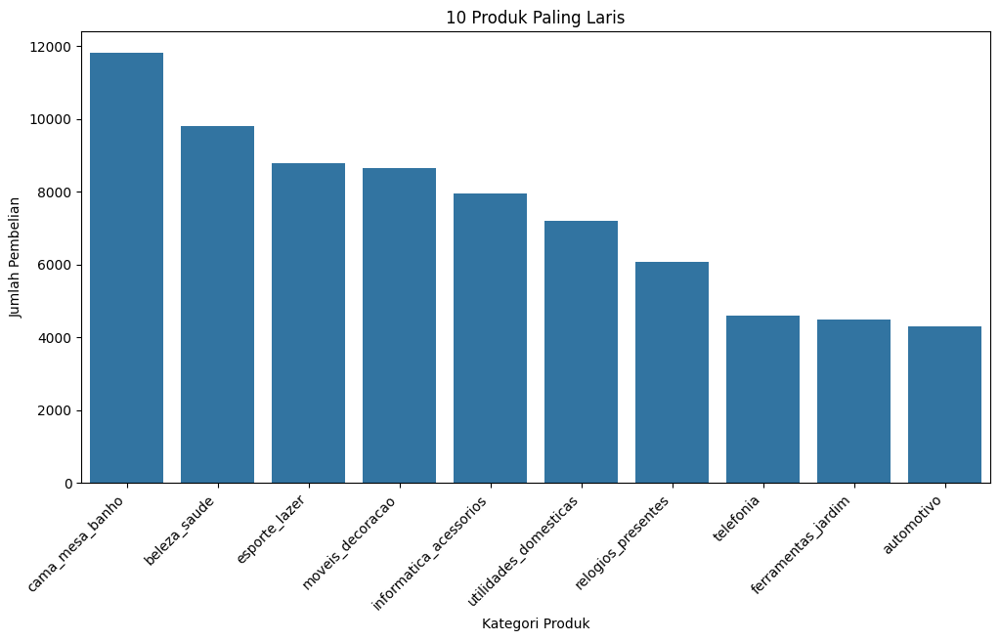

In [ ]:
# Gabungkan data produk dan order_items untuk mendapatkan nama produk
product_order_data = pd.merge(merged_data, products_data[['product_id', 'product_category_name']], on='product_id', how='left')

# Hitung jumlah pembelian setiap produk
product_sales_count = product_order_data.groupby('product_category_name_y')['order_id'].count().sort_values(ascending=False)

# Tampilkan 10 produk paling laris
top_10_products = product_sales_count.head(10)

# Visualisasi dengan bar chart
plt.figure(figsize=(12, 6))
sns.barplot(x=top_10_products.index, y=top_10_products.values)
plt.title('10 Produk Paling Laris')
plt.xlabel('Kategori Produk')
plt.ylabel('Jumlah Pembelian')
plt.xticks(rotation=45, ha='right')
plt.show()

Insight dari visualisasi "10 Produk Paling Laris"

* Produk 'cama_mesa_banho' (bed, table, bath) merupakan produk yang paling banyak dibeli.
*  Kategori produk 'esporte_lazer' (sports & leisure), 'beleza_saude' (beauty & health),
   dan 'moveis_decoracao' (furniture & decoration) juga termasuk produk populer.

Visualisasi ini membantu kita memahami produk-produk mana yang paling diminati oleh pelanggan. Hal ini dapat digunakan untuk strategi bisnis, seperti menentukan produk mana yang harus dipromosikan lebih lanjut atau persediaan produk mana yang perlu ditingkatkan.

### Pertanyaan 2: Berapa banyak pelanggan yang melakukan pembelian berulang?

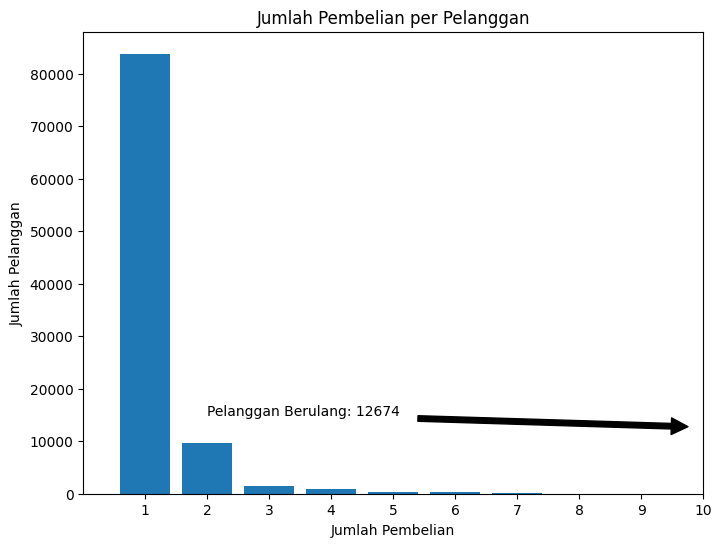

In [ ]:
# Hitung jumlah pembelian per pelanggan
customer_purchase_count = merged_data.groupby('customer_id')['order_id'].count()

# Filter pelanggan yang melakukan pembelian lebih dari 1 kali
repeat_customers = customer_purchase_count[customer_purchase_count > 1]

# Hitung jumlah pelanggan yang melakukan pembelian berulang
num_repeat_customers = len(repeat_customers)

# Visualisasikan data jumlah pembelian dengan bar chart
plt.figure(figsize=(8, 6))
plt.bar(customer_purchase_count.value_counts().index, customer_purchase_count.value_counts().values)
plt.title('Jumlah Pembelian per Pelanggan')
plt.xlabel('Jumlah Pembelian')
plt.ylabel('Jumlah Pelanggan')
plt.xticks(range(1, customer_purchase_count.max() + 1))
plt.xlim(0, 10)
plt.annotate(f'Pelanggan Berulang: {num_repeat_customers}', xy=(10, 12674), xytext=(2, 15000),
             arrowprops=dict(facecolor='black', shrink=0.05))
plt.show()

Insight dari visualisasi "Jumlah Pembelian per Pelanggan"

* Sebagian besar pelanggan hanya melakukan satu kali pembelian.
* Jumlah pelanggan yang melakukan pembelian berulang relatif kecil dibandingkan dengan pelanggan yang hanya melakukan satu kali pembelian.
* Kita dapat melihat dari histogram bahwa ada beberapa pelanggan yang melakukan pembelian lebih dari 5 kali, menunjukkan bahwa mereka adalah pelanggan setia.

Informasi ini dapat digunakan untuk mengidentifikasi pelanggan setia dan mengembangkan strategi untuk mempertahankan mereka. Memahami perilaku pembelian pelanggan dapat membantu dalam mengembangkan strategi pemasaran yang lebih efektif dan meningkatkan retensi pelanggan.  Misalnya, kita bisa memberikan penawaran khusus kepada pelanggan setia atau memberikan program loyalitas untuk mendorong mereka melakukan pembelian berulang.

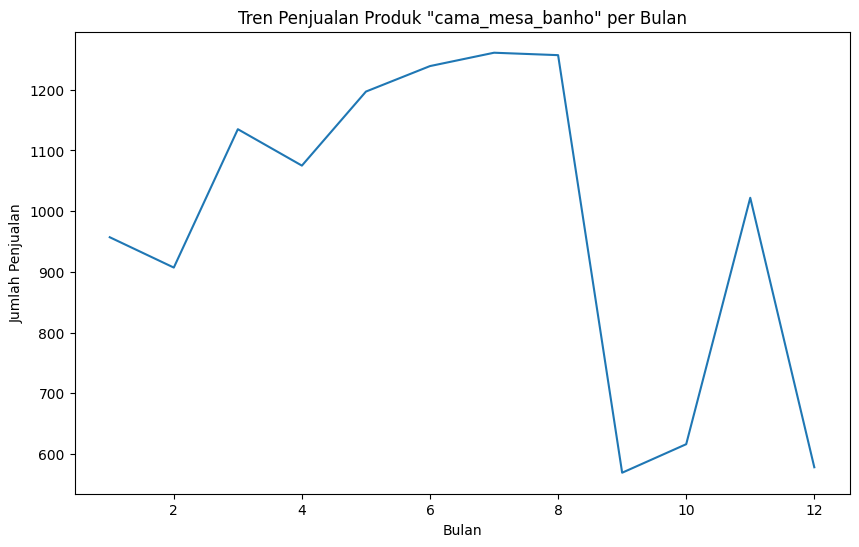

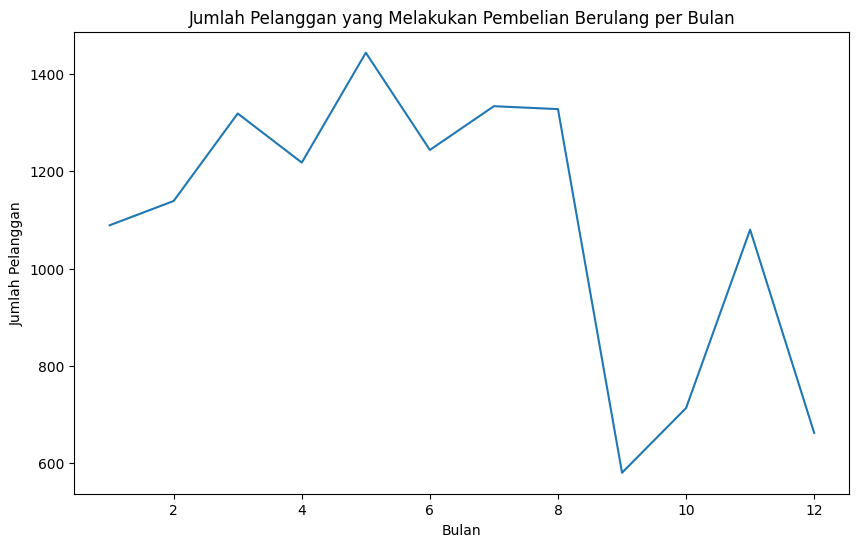

In [ ]:
# Analisis tren penjualan produk "cama_mesa_banho" selama periode waktu tertentu
product_order_data_cama = product_order_data[product_order_data['product_category_name_y'] == 'cama_mesa_banho']
sales_trend_cama = product_order_data_cama.groupby(product_order_data_cama['order_purchase_timestamp'].dt.month)['order_id'].count()
plt.figure(figsize=(10, 6))
plt.plot(sales_trend_cama.index, sales_trend_cama.values)
plt.title('Tren Penjualan Produk "cama_mesa_banho" per Bulan')
plt.xlabel('Bulan')
plt.ylabel('Jumlah Penjualan')
plt.show()

# Menampilkan insight tentang jumlah pembelian berulang per bulan
monthly_repeat_customers = merged_data.groupby([merged_data['order_purchase_timestamp'].dt.month, 'customer_unique_id'])['order_id'].count().reset_index()
monthly_repeat_customers = monthly_repeat_customers[monthly_repeat_customers['order_id'] > 1].groupby('order_purchase_timestamp')['customer_unique_id'].nunique()
plt.figure(figsize=(10, 6))
plt.plot(monthly_repeat_customers.index, monthly_repeat_customers.values)
plt.title('Jumlah Pelanggan yang Melakukan Pembelian Berulang per Bulan')
plt.xlabel('Bulan')
plt.ylabel('Jumlah Pelanggan')
plt.show()

Insight dari analisis yang telah dilakukan:

* Produk Terlaris:
   - Kategori produk "cama_mesa_banho" (tempat tidur, meja, kamar mandi) adalah yang paling banyak dibeli oleh pelanggan.
   - Ini menunjukkan bahwa produk-produk rumah tangga dan keperluan sehari-hari memiliki permintaan yang tinggi.
   -  Kategori lain yang juga populer meliputi "esporte_lazer" (olahraga dan waktu luang), "beleza_saude" (kecantikan dan kesehatan), dan "moveis_decoracao" (furnitur dan dekorasi).

* Pembelian Berulang:
   - Mayoritas pelanggan hanya melakukan pembelian satu kali di platform e-commerce ini.
   -  Jumlah pelanggan yang melakukan pembelian berulang relatif kecil.
   - Ini menunjukkan bahwa tingkat retensi pelanggan masih bisa ditingkatkan.
   - Potensi peningkatan retensi pelanggan dapat dicapai melalui strategi pemasaran yang efektif yang berfokus pada pengalaman pelanggan dan loyalitas.

* Tren Penjualan:
   -  Tren penjualan produk "cama_mesa_banho" dapat divisualisasikan lebih lanjut untuk melihat fluktuasi penjualan bulanan atau tahunan.
   -  Memahami tren penjualan produk dapat membantu dalam perencanaan stok dan promosi yang lebih baik.
   - Analisis lebih lanjut dapat mencakup pengelompokan pelanggan berdasarkan jenis produk yang dibeli untuk mengidentifikasi segmen pelanggan yang loyal terhadap kategori tertentu.

* Pelanggan Berulang Bulanan:
   - Melalui visualisasi jumlah pelanggan yang melakukan pembelian berulang per bulan, kita dapat melihat apakah ada pola musiman dalam pembelian berulang.
   - Peningkatan jumlah pelanggan yang melakukan pembelian berulang pada bulan-bulan tertentu dapat mengindikasikan efektivitas promosi atau kampanye pemasaran yang dilakukan pada periode tersebut.

Kesimpulan:

- Data ini memberikan wawasan berharga tentang perilaku pelanggan, produk populer, dan potensi peningkatan bisnis.
-  Memfokuskan strategi pada meningkatkan retensi pelanggan dan memahami tren penjualan dapat berkontribusi pada pertumbuhan bisnis yang berkelanjutan.
-  Analisis lebih lanjut dapat dilakukan untuk mengidentifikasi segmen pelanggan, memahami faktor yang mempengaruhi pembelian, dan mengoptimalkan strategi pemasaran yang lebih efektif.

### Pertanyaan 3: Berapa rata-rata nilai transaksi per pelanggan?

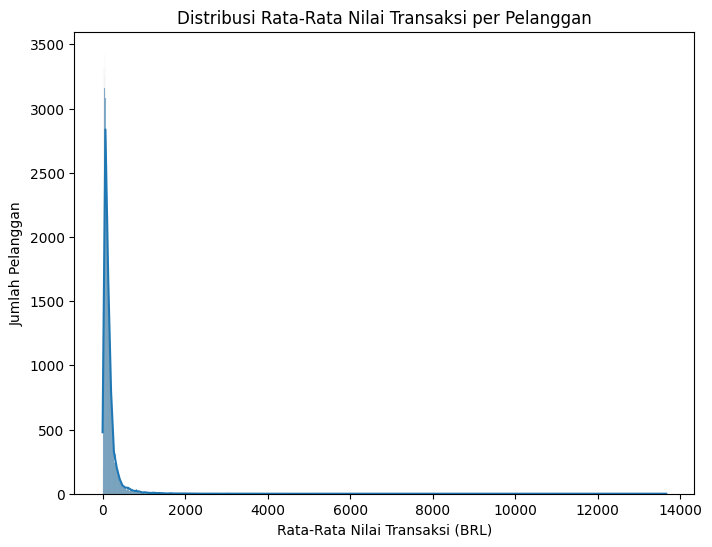


Rata-rata nilai transaksi per pelanggan: 157.78


In [ ]:
# Hitung total nilai transaksi per pelanggan
average_transaction_value = merged_data.groupby('customer_unique_id')['payment_value'].mean()

# Hitung rata-rata nilai transaksi per pelanggan
average_transaction_overall = average_transaction_value.mean()

# Visualisasikan distribusi nilai transaksi per pelanggan
plt.figure(figsize=(8, 6))
sns.histplot(average_transaction_value, kde=True)
plt.title('Distribusi Rata-Rata Nilai Transaksi per Pelanggan')
plt.xlabel('Rata-Rata Nilai Transaksi (BRL)')
plt.ylabel('Jumlah Pelanggan')
plt.show()

print(f"\nRata-rata nilai transaksi per pelanggan: {average_transaction_overall:.2f}")

### Pertanyaan 4: Kategori produk apa yang paling menghasilkan pendapatan?

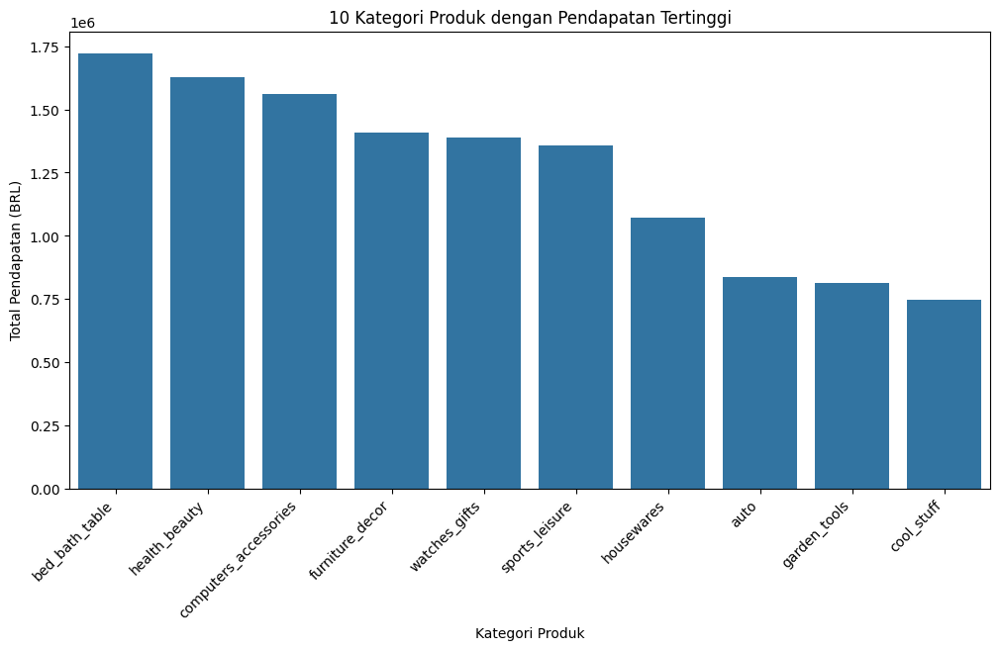

In [ ]:
# Hitung total pendapatan per kategori produk
revenue_per_category = merged_data.groupby('product_category_name_english')['payment_value'].sum().sort_values(ascending=False)

# Tampilkan 10 kategori produk dengan pendapatan tertinggi
top_10_revenue_categories = revenue_per_category.head(10)

# Visualisasi dengan bar chart
plt.figure(figsize=(12, 6))
sns.barplot(x=top_10_revenue_categories.index, y=top_10_revenue_categories.values)
plt.title('10 Kategori Produk dengan Pendapatan Tertinggi')
plt.xlabel('Kategori Produk')
plt.ylabel('Total Pendapatan (BRL)')
plt.xticks(rotation=45, ha='right')
plt.show()

Insight dari visualisasi "10 Kategori Produk dengan Pendapatan Tertinggi"

* Kategori Produk Teratas:
   - Kategori produk "bed_bath_table", "health_beauty", dan "sports_leisure" adalah tiga kategori produk dengan pendapatan tertinggi.
   - Hal ini menunjukkan bahwa produk-produk di kategori rumah tangga, perawatan diri, dan olahraga dan rekreasi berkontribusi paling besar terhadap pendapatan bisnis.

* Perbedaan Pendapatan Antar Kategori:
   - Terdapat perbedaan yang cukup signifikan antara pendapatan kategori produk teratas dengan kategori lainnya.
   - Ini menunjukkan bahwa beberapa kategori produk memiliki daya tarik dan potensi keuntungan yang lebih besar.

* Potensi Pengembangan:
   - Visualisasi ini dapat menjadi dasar untuk strategi pengembangan bisnis.
   - Misalnya, bisnis dapat mempertimbangkan untuk memperluas portofolio produk di kategori dengan pendapatan tinggi, atau meningkatkan promosi produk di kategori tersebut.
   - Selain itu, bisnis dapat juga menganalisis mengapa beberapa kategori produk memiliki pendapatan yang tinggi, misalnya melalui analisis harga, kualitas produk, dan strategi pemasaran.

* Informasi ini dapat membantu bisnis dalam mengambil keputusan strategis seperti:
  - Menentukan strategi promosi dan pemasaran yang efektif untuk kategori produk dengan pendapatan tinggi.
  - Mengoptimalkan persediaan produk di kategori yang memiliki permintaan tinggi.
  - Memperkenalkan produk baru yang inovatif dan potensial dalam kategori yang prospektif.
  - Menentukan target pasar yang spesifik untuk kategori produk tertentu.

### Pertanyaan 5: Metode pembayaran apa yang paling sering digunakan oleh pelanggan?

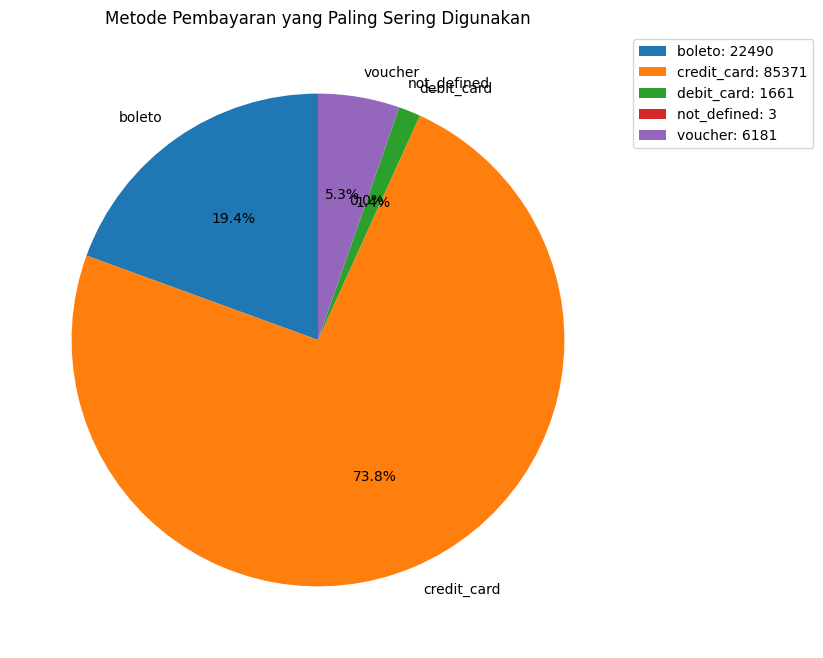

In [ ]:
# Hitung jumlah penggunaan setiap metode pembayaran
payment_method_counts = merged_data.groupby('payment_type')['order_id'].count()

# Visualisasi dengan pie chart
plt.figure(figsize=(8, 8))
plt.pie(payment_method_counts, labels=payment_method_counts.index, autopct='%1.1f%%', startangle=90)
plt.title('Metode Pembayaran yang Paling Sering Digunakan')
legend_labels = [f'{label}: {count}' for label, count in zip(payment_method_counts.index, payment_method_counts)]
plt.legend(legend_labels, loc='upper left', bbox_to_anchor=(1, 1))
plt.show()

Insight dari visualisasi "Metode Pembayaran yang Paling Sering Digunakan"

* Metode Pembayaran Dominan:
   - Metode pembayaran "credit_card" adalah metode yang paling banyak digunakan oleh pelanggan, dengan persentase yang signifikan.
   - Ini menunjukkan bahwa kartu kredit merupakan metode pembayaran yang populer dan nyaman bagi pelanggan di platform e-commerce ini.

* Metode Pembayaran Lainnya:
   - Metode pembayaran lainnya seperti "boleto", "voucher", dan "debit_card" juga digunakan, meskipun dalam proporsi yang lebih kecil.
   - Ini menunjukkan bahwa platform menyediakan berbagai pilihan metode pembayaran untuk mengakomodasi preferensi pelanggan yang berbeda.

* Implikasi Bisnis:
   - Memahami metode pembayaran yang paling sering digunakan oleh pelanggan dapat membantu bisnis dalam mengoptimalkan proses transaksi dan mengurangi biaya transaksi.
   - Misalnya, jika sebagian besar pelanggan menggunakan kartu kredit, bisnis dapat mempertimbangkan untuk menawarkan promosi atau diskon khusus untuk transaksi dengan kartu kredit.
   - Selain itu, bisnis dapat juga memastikan bahwa sistem pembayaran mereka mendukung berbagai metode pembayaran yang populer untuk meningkatkan kenyamanan pelanggan.

Kesimpulan:
   - Visualisasi ini memberikan wawasan tentang preferensi pelanggan dalam metode pembayaran.
   - Informasi ini dapat menjadi dasar untuk mengoptimalkan strategi bisnis dan meningkatkan pengalaman pelanggan.

### Pertanyaan 6: Bagaimana tingkat kepuasan pelanggan terhadap layanan dan produk yang ditawarkan?

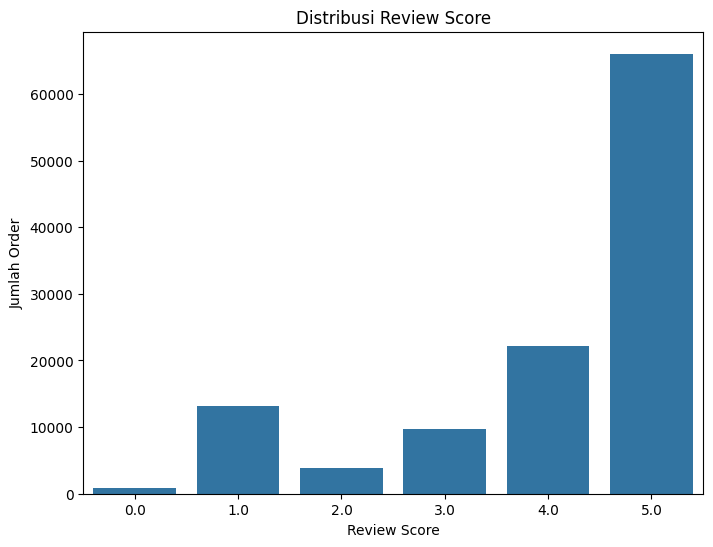

In [ ]:
# Analisis review score
review_score_counts = merged_data.groupby('review_score')['order_id'].count()

# Visualisasi dengan bar chart
plt.figure(figsize=(8, 6))
sns.barplot(x=review_score_counts.index, y=review_score_counts.values)
plt.title('Distribusi Review Score')
plt.xlabel('Review Score')
plt.ylabel('Jumlah Order')
plt.show()

Insight dari visualisasi "Distribusi Review Score"

* Mayoritas Pelanggan Puas:
  - Sebagian besar pelanggan memberikan review score yang tinggi (4 dan 5), menunjukkan bahwa tingkat kepuasan pelanggan terhadap layanan dan produk yang ditawarkan cukup baik.

* Beberapa Pelanggan Tidak Puas:
  - Terdapat juga beberapa pelanggan yang memberikan review score yang rendah (1, 2, dan 3), menunjukkan bahwa masih ada beberapa area yang perlu ditingkatkan dalam hal layanan dan produk.

* Potensi Peningkatan:
  - Memahami alasan di balik review score yang rendah dapat membantu bisnis dalam meningkatkan kualitas produk dan layanan yang ditawarkan.
  - Bisnis dapat menganalisis review comment untuk mendapatkan masukan dan saran dari pelanggan yang tidak puas.
  - Melalui upaya perbaikan, bisnis dapat meningkatkan kepuasan pelanggan dan mengurangi jumlah review score rendah.

Kesimpulan:
- Visualisasi review score memberikan wawasan berharga tentang tingkat kepuasan pelanggan terhadap layanan dan produk yang ditawarkan.
- Memahami distribusi review score dan menganalisis review comment dapat membantu bisnis dalam meningkatkan kualitas produk dan layanan yang ditawarkan.



---



#Analisis Lanjutan (Opsional)

In [ ]:
# Ambil data latitude dan longitude dari merged_with_geolocation
latitude = merged_with_geolocation['geolocation_lat'].dropna().tolist()
longitude = merged_with_geolocation['geolocation_lng'].dropna().tolist()

# Buat peta dengan pusat di Brazil
map_brazil = folium.Map(location=[-14.2350, -51.9253], zoom_start=4)

# Beri opsi mengubah jenis map
folium.TileLayer('Stamen Terrain', attr='Stamen Design').add_to(map_brazil)

# Tambahkan MarkerCluster untuk mengelompokkan marker
marker_cluster = MarkerCluster().add_to(map_brazil)

# Tambahkan marker untuk setiap lokasi
for lat, lng in zip(latitude, longitude):
    folium.Marker([lat, lng]).add_to(marker_cluster)

# Tampilkan peta
map_brazil

Insight dari visualisasi peta:

Peta menunjukkan distribusi geografis aktivitas e-commerce di Brazil.
Kita dapat mengamati bahwa sebagian besar aktivitas terkonsentrasi di daerah-daerah tertentu di Brazil,
seperti wilayah tenggara dan selatan,  yang menandakan bahwa daerah-daerah tersebut
mungkin memiliki tingkat penetrasi e-commerce yang lebih tinggi dibandingkan daerah lain.
Konsentrasi aktivitas e-commerce di area-area tertentu dapat
membantu kita memahami pusat-pusat pertumbuhan ekonomi dan juga membantu
dalam perencanaan logistik dan distribusi produk.

Dari peta, kita bisa mendapatkan informasi tambahan seperti:
* Daerah dengan aktivitas e-commerce yang tinggi:
  - Dapat menunjukkan potensi pasar yang besar di daerah-daerah tersebut.
  - Dapat menjadi lokasi strategis untuk penempatan gudang atau pusat distribusi.
* Daerah dengan aktivitas e-commerce yang rendah:
  - Dapat menunjukkan peluang ekspansi ke pasar baru.
  -  Strategi pemasaran perlu disesuaikan untuk daerah-daerah tersebut.
* Sebaran penjual dan pembeli:
   - Kita dapat melihat apakah terdapat korelasi antara lokasi penjual dan pembeli.
   - Hal ini dapat membantu dalam mengoptimalkan proses pengiriman dan mengurangi waktu pengiriman.

Dengan menganalisis lebih lanjut informasi dari peta ini,
kita dapat memahami dinamika pasar e-commerce di Brazil secara lebih mendalam,
membantu dalam perencanaan strategis dan pengambilan keputusan bisnis yang lebih baik.



---



#Conclusion

Dari analisis data e-commerce Brazil yang telah dilakukan, kita mendapatkan beberapa insight penting yang dapat digunakan untuk meningkatkan strategi bisnis:

1. Produk Terlaris:
   - Kategori produk "cama_mesa_banho" (tempat tidur, meja, kamar mandi) adalah yang paling banyak dibeli.
   - Hal ini menunjukkan bahwa produk-produk rumah tangga dan keperluan sehari-hari memiliki permintaan yang tinggi.
   - Strategi bisnis: Meningkatkan stok dan promosi produk di kategori ini, serta mempertimbangkan untuk memperluas portofolio produk terkait.


2. Pembelian Berulang:
   - Mayoritas pelanggan hanya melakukan pembelian satu kali.
   - Tingkat retensi pelanggan masih bisa ditingkatkan.
   - Strategi bisnis: Mengembangkan strategi pemasaran yang berfokus pada pengalaman pelanggan dan loyalitas, misalnya program loyalitas, penawaran khusus untuk pelanggan setia.


3. Tren Penjualan:
   - Memahami tren penjualan produk dapat membantu dalam perencanaan stok dan promosi yang lebih baik.
   - Strategi bisnis: Melakukan analisis tren penjualan produk secara lebih lanjut untuk mengidentifikasi fluktuasi penjualan dan menyesuaikan strategi.


4. Rata-Rata Nilai Transaksi:
   - Memahami rata-rata nilai transaksi per pelanggan dapat membantu bisnis dalam mengoptimalkan strategi pemasaran dan penjualan.
   - Strategi bisnis: Mengembangkan strategi untuk meningkatkan nilai transaksi per pelanggan, misalnya dengan menawarkan produk tambahan atau paket promosi.


5. Kategori Produk dengan Pendapatan Tertinggi:
   - Kategori produk "bed_bath_table", "health_beauty", dan "sports_leisure" adalah tiga kategori produk dengan pendapatan tertinggi.
   - Strategi bisnis: Memperluas portofolio produk di kategori dengan pendapatan tinggi, meningkatkan promosi produk di kategori tersebut, dan menganalisis faktor-faktor yang memengaruhi pendapatan tinggi.


6. Metode Pembayaran:
   - Kartu kredit merupakan metode pembayaran yang paling populer.
   - Strategi bisnis: Mengoptimalkan proses transaksi kartu kredit, memastikan sistem pembayaran mendukung berbagai metode pembayaran.


7. Tingkat Kepuasan Pelanggan:
   - Sebagian besar pelanggan puas dengan layanan dan produk yang ditawarkan.
   - Strategi bisnis: Menganalisis review pelanggan yang tidak puas untuk memahami area yang perlu ditingkatkan, dan melakukan upaya perbaikan untuk meningkatkan kualitas produk dan layanan.

8. Distribusi Geografis:
   - Peta menunjukkan distribusi aktivitas e-commerce di Brazil.
   - Strategi bisnis: Memahami potensi pasar di daerah dengan aktivitas e-commerce yang tinggi, serta peluang ekspansi ke daerah dengan aktivitas e-commerce yang rendah.

Kesimpulan:
   - Data ini memberikan wawasan berharga tentang perilaku pelanggan, produk populer, dan potensi peningkatan bisnis.
   - Memfokuskan strategi pada meningkatkan retensi pelanggan, memahami tren penjualan, dan mengoptimalkan strategi pemasaran dapat berkontribusi pada pertumbuhan bisnis yang berkelanjutan.
   - Analisis lebih lanjut dapat dilakukan untuk mengidentifikasi segmen pelanggan, memahami faktor yang mempengaruhi pembelian, dan mengoptimalkan strategi pemasaran yang lebih efektif.
